# EDA Yelp - Convenience Stores

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import folium
from textblob import TextBlob
import nltk
from nltk.corpus import stopwords
from collections import Counter
import nltk
nltk.download('punkt')

import warnings
warnings.filterwarnings("ignore")

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\MaysonPenayo\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


#### inserta datasets

- Business

In [4]:
df_business = pd.read_parquet('D:/MaysonPenayo/Escritorio/proyecto final/yelp/business.parquet')
df_business

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,None,93101,34.426679,-119.711197,5.0,7,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Doctors, Traditional Chinese Medicine, Naturop...",None
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,None,63123,38.551126,-90.335695,3.0,15,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shipping Centers, Local Services, Notaries, Ma...","{'Friday': '8:0-18:30', 'Monday': '0:0-0:0', '..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,None,85711,32.223236,-110.880452,3.5,22,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Department Stores, Shopping, Fashion, Home & G...","{'Friday': '8:0-23:0', 'Monday': '8:0-22:0', '..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,CA,19107,39.955505,-75.155564,4.0,80,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Friday': '7:0-21:0', 'Monday': '7:0-20:0', '..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,MO,18054,40.338183,-75.471659,4.5,13,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Brewpubs, Breweries, Food","{'Friday': '12:0-22:0', 'Monday': None, 'Satur..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150341,IUQopTMmYQG-qRtBk-8QnA,Binh's Nails,3388 Gateway Blvd,Edmonton,IN,T6J 5H2,53.468419,-113.492054,3.0,13,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Nail Salons, Beauty & Spas","{'Friday': '10:0-19:30', 'Monday': '10:0-19:30..."
150342,c8GjPIOTGVmIemT7j5_SyQ,Wild Birds Unlimited,2813 Bransford Ave,Nashville,DE,37204,36.115118,-86.766925,4.0,5,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Pets, Nurseries & Gardening, Pet Stores, Hobby...","{'Friday': '9:30-17:30', 'Monday': '9:30-17:30..."
150343,_QAMST-NrQobXduilWEqSw,Claire's Boutique,"6020 E 82nd St, Ste 46",Indianapolis,AB,46250,39.908707,-86.065088,3.5,8,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shopping, Jewelry, Piercing, Toy Stores, Beaut...",None
150344,mtGm22y5c2UHNXDFAjaPNw,Cyclery & Fitness Center,2472 Troy Rd,Edwardsville,AB,62025,38.782351,-89.950558,4.0,24,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Fitness/Exercise Equipment, Eyewear & Optician...","{'Friday': '9:0-20:0', 'Monday': '9:0-20:0', '..."


- Data Review

In [5]:
df_review =  pd.read_parquet('D:/MaysonPenayo/Escritorio/proyecto final/review.parquet')
df_review

,review_id,user_id,business_id,stars,useful,funny,cool,text,date
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15
...,...,...,...,...,...,...,...,...,...
6990275,t-2o35kr7Q9DSaeuKhaDuQ,oX7o1TH0PHUWp9r9ry9_vw,jLn69WQupjsDKrbPw_nlGQ,3,0,1,0,Never really had any issues here other than th...,2017-11-15 09:43:07
6990276,fLIwWCvdul9PNWYfJt5QWA,v8wlapFKVLs2qTYCGhCdiw,t6v8g8UeNiq3O2GoEc7R4Q,4,0,0,0,Fish recently moved a couple of doors down the...,2014-09-03 18:27:33
6990277,ETAiy6wEM-r9ve4SKDhBpg,rLlYc1RzIBnOmnX3AbpEYw,ZYRul0i1bhOjirHED6Kd0w,3,0,0,0,I've been to South House around a dozen or so ...,2016-02-20 22:25:29
6990278,8OgvSXuc6KjAt2fSz9LuzA,eEH-8CEPU5ndPxDGzVfHiQ,onGXKwnxPLtKnO8yqQMPSA,1,1,0,1,Wow! I am shocked at these reviews. I have tri...,2010-06-27 02:17:30


In [6]:
df_user = pd.read_parquet('D:/MaysonPenayo/Escritorio/proyecto final/yelp/user.parquet')
df_user

,user_id,name,review_count,yelping_since,useful,funny,cool,elite,friends,fans,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,qVc8ODYU5SZjKXVBgXdI7w,Walker,585,2007-01-25 16:47:26,7217,1259,5994,2007,"NSCy54eWehBJyZdG2iE84w, pe42u7DcCH2QmI81NX-8qA...",267,...,65,55,56,18,232,844,467,467,239,180
1,j14WgRoU_-2ZE1aw1dXrJg,Daniel,4333,2009-01-25 04:35:42,43091,13066,27281,"2009,2010,2011,2012,2013,2014,2015,2016,2017,2...","ueRPE0CX75ePGMqOFVj6IQ, 52oH4DrRvzzl8wh5UXyU0A...",3138,...,264,184,157,251,1847,7054,3131,3131,1521,1946
2,2WnXYQFK0hXEoTxPtV2zvg,Steph,665,2008-07-25 10:41:00,2086,1010,1003,"2009,2010,2011,2012,2013","LuO3Bn4f3rlhyHIaNfTlnA, j9B4XdHUhDfTKVecyWQgyA...",52,...,13,10,17,3,66,96,119,119,35,18
3,SZDeASXq7o05mMNLshsdIA,Gwen,224,2005-11-29 04:38:33,512,330,299,"2009,2010,2011","enx1vVPnfdNUdPho6PH_wg, 4wOcvMLtU6a9Lslggq74Vg...",28,...,4,1,6,2,12,16,26,26,10,9
4,hA5lMy-EnncsH4JoR-hFGQ,Karen,79,2007-01-05 19:40:59,29,15,7,,"PBK4q9KEEBHhFvSXCUirIw, 3FWPpM7KU1gXeOM_ZbYMbA...",1,...,1,0,0,0,1,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2105592,4QGxxakRZeOlg_qDuxmTeQ,Jennilee,38,2012-01-19 23:33:02,74,9,6,,kmwNG5LZSHFmveg6wYYdrw,0,...,1,0,0,0,1,4,0,0,1,0
2105593,tmelBbVBGAzXBVfH2u_R6g,Gerry,19,2009-06-09 16:34:54,14,5,2,,"BFYdCAMFyjYHDwesndEXEg, _9fTIqfSJc7g3V_o76XRVg...",1,...,1,0,0,0,0,1,0,0,0,0
2105594,tpBznnD6uJN3m_pJubj09w,Emily,26,2013-08-13 23:18:11,4,1,2,,"bKV3ly2MuK-K1cptMrFknQ, liel18zRoSB4tEkUP7i6Cg...",0,...,0,0,0,0,1,0,0,0,0,0
2105595,Kst_srPw7GdYydMFYdCtzw,Heatheranne,25,2015-01-10 00:06:25,21,2,5,,"dzHTk52vbGtbktRm_B-wEg, fOfFLV7IbBDN6lzARaLqdg...",0,...,0,0,0,0,0,1,0,0,0,0


## Correcciones y Analisis
Esta sección pretende explorar los datos para comprender su distibución y obtetener conclusiones generales.

## 1. Business

In [7]:
df_business = df_business.drop(columns=['state'], axis=1)
df_business

,business_id,name,address,city,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,93101,34.426679,-119.711197,5.0,7,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Doctors, Traditional Chinese Medicine, Naturop...",None
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,63123,38.551126,-90.335695,3.0,15,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shipping Centers, Local Services, Notaries, Ma...","{'Friday': '8:0-18:30', 'Monday': '0:0-0:0', '..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,85711,32.223236,-110.880452,3.5,22,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Department Stores, Shopping, Fashion, Home & G...","{'Friday': '8:0-23:0', 'Monday': '8:0-22:0', '..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,19107,39.955505,-75.155564,4.0,80,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Friday': '7:0-21:0', 'Monday': '7:0-20:0', '..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,18054,40.338183,-75.471659,4.5,13,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Brewpubs, Breweries, Food","{'Friday': '12:0-22:0', 'Monday': None, 'Satur..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
150341,IUQopTMmYQG-qRtBk-8QnA,Binh's Nails,3388 Gateway Blvd,Edmonton,T6J 5H2,53.468419,-113.492054,3.0,13,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Nail Salons, Beauty & Spas","{'Friday': '10:0-19:30', 'Monday': '10:0-19:30..."
150342,c8GjPIOTGVmIemT7j5_SyQ,Wild Birds Unlimited,2813 Bransford Ave,Nashville,37204,36.115118,-86.766925,4.0,5,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Pets, Nurseries & Gardening, Pet Stores, Hobby...","{'Friday': '9:30-17:30', 'Monday': '9:30-17:30..."
150343,_QAMST-NrQobXduilWEqSw,Claire's Boutique,"6020 E 82nd St, Ste 46",Indianapolis,46250,39.908707,-86.065088,3.5,8,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shopping, Jewelry, Piercing, Toy Stores, Beaut...",None
150344,mtGm22y5c2UHNXDFAjaPNw,Cyclery & Fitness Center,2472 Troy Rd,Edwardsville,62025,38.782351,-89.950558,4.0,24,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Fitness/Exercise Equipment, Eyewear & Optician...","{'Friday': '9:0-20:0', 'Monday': '9:0-20:0', '..."


agrega al archivo business la correccion de los estados, ya que estaban mal indicados ademas de eliminar datos que no pertenecen a Estados Unidos

In [8]:
# 1. Convert latitude and longitude to Point objects
us_state = gpd.read_file('D:/MaysonPenayo/Escritorio/cb_2018_us_state_500k')

df_business["geometry"] = df_business.apply(lambda row: Point(row["longitude"], row["latitude"]), axis=1)

# 2. Cast us_states geometry to a GeoDataFrame (if not already)
us_state = gpd.GeoDataFrame(us_state)

# 3. Function to check if point is within a state polygon
def is_within_state(point, state_geometry):
  return point.within(state_geometry)

# 4. Create a new column in business to store the state name
df_business["state_name"] = None

# 5. Loop through each point and assign corresponding state information
for index, row in df_business.iterrows():
  point = row["geometry"]
  for state_index, state_row in us_state.iterrows():
    state_geom = state_row["geometry"]
    if is_within_state(point, state_geom):
      df_business.at[index, "state_name"] = state_row["NAME"]
      df_business.at[index, "state_code"] = state_row["STUSPS"]  # Add new column
      break  # Stop checking after finding the state
# 6. Drop columns no longer needed

df_business = df_business.drop('geometry', axis=1)

# Now, business has two new columns "state_name" and "state_code" with the corrected state information for each point
df_business

,business_id,name,address,city,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,state_name,state_code
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,93101,34.426679,-119.711197,5.0,7,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Doctors, Traditional Chinese Medicine, Naturop...",None,California,CA
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,63123,38.551126,-90.335695,3.0,15,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shipping Centers, Local Services, Notaries, Ma...","{'Friday': '8:0-18:30', 'Monday': '0:0-0:0', '...",Missouri,MO
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,85711,32.223236,-110.880452,3.5,22,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Department Stores, Shopping, Fashion, Home & G...","{'Friday': '8:0-23:0', 'Monday': '8:0-22:0', '...",Arizona,AZ
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,19107,39.955505,-75.155564,4.0,80,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Friday': '7:0-21:0', 'Monday': '7:0-20:0', '...",Pennsylvania,PA
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,18054,40.338183,-75.471659,4.5,13,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Brewpubs, Breweries, Food","{'Friday': '12:0-22:0', 'Monday': None, 'Satur...",Pennsylvania,PA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150341,IUQopTMmYQG-qRtBk-8QnA,Binh's Nails,3388 Gateway Blvd,Edmonton,T6J 5H2,53.468419,-113.492054,3.0,13,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Nail Salons, Beauty & Spas","{'Friday': '10:0-19:30', 'Monday': '10:0-19:30...",None,NaN
150342,c8GjPIOTGVmIemT7j5_SyQ,Wild Birds Unlimited,2813 Bransford Ave,Nashville,37204,36.115118,-86.766925,4.0,5,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Pets, Nurseries & Gardening, Pet Stores, Hobby...","{'Friday': '9:30-17:30', 'Monday': '9:30-17:30...",Tennessee,TN
150343,_QAMST-NrQobXduilWEqSw,Claire's Boutique,"6020 E 82nd St, Ste 46",Indianapolis,46250,39.908707,-86.065088,3.5,8,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shopping, Jewelry, Piercing, Toy Stores, Beaut...",None,Indiana,IN
150344,mtGm22y5c2UHNXDFAjaPNw,Cyclery & Fitness Center,2472 Troy Rd,Edwardsville,62025,38.782351,-89.950558,4.0,24,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Fitness/Exercise Equipment, Eyewear & Optician...","{'Friday': '9:0-20:0', 'Monday': '9:0-20:0', '...",Illinois,IL


visualiza las filas a borrar

In [9]:
# Select rows with null values in "state_corrected"
null_state_business = df_business[df_business["state_name"].isnull()]
null_state_business

,business_id,name,address,city,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,state_name,state_code
20,WKMJwqnfZKsAae75RMP6jA,Roast Coffeehouse and Wine Bar,10359 104 Street NW,Edmonton,T5J 1B9,53.546045,-113.499169,4.0,40,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Coffee & Tea, Food, Cafes, Bars, Wine Bars, Re...","{'Friday': '8:0-18:0', 'Monday': '8:0-18:0', '...",None,NaN
46,JX4tUpd09YFchLBuI43lGw,Naked Cyber Cafe & Espresso Bar,10303 108 Street NW,Edmonton,T5J 1L7,53.544682,-113.506589,4.0,12,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Arts & Entertainment, Music Venues, Internet S...","{'Friday': '11:0-1:0', 'Monday': '11:0-1:0', '...",None,NaN
52,5BmQX4UVJY19mMtafMg7JA,Breadland Organic Whole Grain Bakery,"11642 104 Avenue, Unit 642",Edmonton,T5K 2T7,53.547205,-113.522448,4.0,23,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Specialty Food, Bakeries, Food, Health Markets","{'Friday': '9:0-18:0', 'Monday': '9:0-18:0', '...",None,NaN
53,cVBxfMC4lp3DnocjYA3FHQ,Paws The Cat Cafe,10588 109 Street,Edmonton,T5H 3B2,53.549633,-113.508780,5.0,20,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Coffee & Tea, Cafes, Pets, Restaurants, Pet Ad...","{'Friday': '10:0-20:0', 'Monday': '0:0-0:0', '...",None,NaN
77,mFTaYsRDyeFaY2NDLfSaAA,River City Games,5203 99 Street NW,Edmonton,T6E 5B7,53.489312,-113.485567,4.5,5,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Tabletop Games, Shopping, Sporting Goods","{'Friday': '10:0-18:0', 'Monday': '10:0-18:0',...",None,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150263,VRSQk67FPiDQolDyiaFnjg,Citytv,10212 Jasper Ave NW,Edmonton,T5J 5A3,53.541168,-113.495953,4.0,8,1,None,"Television Stations, Mass Media",None,None,NaN
150276,Rn3DtOiuJtc3whFySWXs5Q,Japanese Village,2940 Calgary Trail NW,Edmonton,T6J 7C2,53.463917,-113.494702,3.0,35,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Japanese, Restaurants, Steakhouses, Sushi Bars","{'Friday': '17:0-22:0', 'Monday': '0:0-0:0', '...",None,NaN
150332,t_SGoRT5yt14OWr64TOulA,Sherwood Park Kwik Lube,979 Fir St,Sherwood Park,T8A 4N5,53.513215,-113.328680,5.0,5,1,None,"Oil Change Stations, Automotive, Auto Repair",None,None,NaN
150340,hn9Toz3s-Ei3uZPt7esExA,West Side Kebab House,2470 Guardian Road NW,Edmonton,T5T 1K8,53.509649,-113.675999,4.5,18,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Middle Eastern, Restaurants","{'Friday': '11:0-22:0', 'Monday': '11:0-22:0',...",None,NaN


borra los datos no utiles

In [10]:
# Elimina las filas identificadas con valores nulos en "state_name"
df_business = df_business.drop(null_state_business.index)

# Imprime el DataFrame modificado
df_business

,business_id,name,address,city,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,state_name,state_code
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,93101,34.426679,-119.711197,5.0,7,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Doctors, Traditional Chinese Medicine, Naturop...",None,California,CA
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,63123,38.551126,-90.335695,3.0,15,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shipping Centers, Local Services, Notaries, Ma...","{'Friday': '8:0-18:30', 'Monday': '0:0-0:0', '...",Missouri,MO
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,85711,32.223236,-110.880452,3.5,22,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Department Stores, Shopping, Fashion, Home & G...","{'Friday': '8:0-23:0', 'Monday': '8:0-22:0', '...",Arizona,AZ
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,19107,39.955505,-75.155564,4.0,80,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Friday': '7:0-21:0', 'Monday': '7:0-20:0', '...",Pennsylvania,PA
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,18054,40.338183,-75.471659,4.5,13,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Brewpubs, Breweries, Food","{'Friday': '12:0-22:0', 'Monday': None, 'Satur...",Pennsylvania,PA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150339,2O2K6SXPWv56amqxCECd4w,The Plum Pit,4405 Pennell Rd,Aston,19014,39.856185,-75.427725,4.5,14,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Restaurants, Comfort Food, Food, Food Trucks, ...","{'Friday': '0:0-0:0', 'Monday': '0:0-0:0', 'Sa...",Pennsylvania,PA
150342,c8GjPIOTGVmIemT7j5_SyQ,Wild Birds Unlimited,2813 Bransford Ave,Nashville,37204,36.115118,-86.766925,4.0,5,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Pets, Nurseries & Gardening, Pet Stores, Hobby...","{'Friday': '9:30-17:30', 'Monday': '9:30-17:30...",Tennessee,TN
150343,_QAMST-NrQobXduilWEqSw,Claire's Boutique,"6020 E 82nd St, Ste 46",Indianapolis,46250,39.908707,-86.065088,3.5,8,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shopping, Jewelry, Piercing, Toy Stores, Beaut...",None,Indiana,IN
150344,mtGm22y5c2UHNXDFAjaPNw,Cyclery & Fitness Center,2472 Troy Rd,Edwardsville,62025,38.782351,-89.950558,4.0,24,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Fitness/Exercise Equipment, Eyewear & Optician...","{'Friday': '9:0-20:0', 'Monday': '9:0-20:0', '...",Illinois,IL


####  Análisis Gráfico.
Genera visualizaciones espaciales y  gráficos para analizar la distribución de los datos. 

- cambia el tipo de dato de las coordenadas para poder visualizar

In [11]:
# Convertir la columna 'longitude' a tipo float
df_business['longitude'] = df_business['longitude'].astype(float)

# Convertir la columna 'latitude' a tipo float
df_business['latitude'] = df_business['latitude'].astype(float)

df_business

,business_id,name,address,city,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours,state_name,state_code
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,93101,34.426679,-119.711197,5.0,7,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Doctors, Traditional Chinese Medicine, Naturop...",None,California,CA
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,63123,38.551126,-90.335695,3.0,15,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shipping Centers, Local Services, Notaries, Ma...","{'Friday': '8:0-18:30', 'Monday': '0:0-0:0', '...",Missouri,MO
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,85711,32.223236,-110.880452,3.5,22,0,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Department Stores, Shopping, Fashion, Home & G...","{'Friday': '8:0-23:0', 'Monday': '8:0-22:0', '...",Arizona,AZ
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,19107,39.955505,-75.155564,4.0,80,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Friday': '7:0-21:0', 'Monday': '7:0-20:0', '...",Pennsylvania,PA
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,18054,40.338183,-75.471659,4.5,13,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Brewpubs, Breweries, Food","{'Friday': '12:0-22:0', 'Monday': None, 'Satur...",Pennsylvania,PA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150339,2O2K6SXPWv56amqxCECd4w,The Plum Pit,4405 Pennell Rd,Aston,19014,39.856185,-75.427725,4.5,14,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Restaurants, Comfort Food, Food, Food Trucks, ...","{'Friday': '0:0-0:0', 'Monday': '0:0-0:0', 'Sa...",Pennsylvania,PA
150342,c8GjPIOTGVmIemT7j5_SyQ,Wild Birds Unlimited,2813 Bransford Ave,Nashville,37204,36.115118,-86.766925,4.0,5,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Pets, Nurseries & Gardening, Pet Stores, Hobby...","{'Friday': '9:30-17:30', 'Monday': '9:30-17:30...",Tennessee,TN
150343,_QAMST-NrQobXduilWEqSw,Claire's Boutique,"6020 E 82nd St, Ste 46",Indianapolis,46250,39.908707,-86.065088,3.5,8,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Shopping, Jewelry, Piercing, Toy Stores, Beaut...",None,Indiana,IN
150344,mtGm22y5c2UHNXDFAjaPNw,Cyclery & Fitness Center,2472 Troy Rd,Edwardsville,62025,38.782351,-89.950558,4.0,24,1,"{'AcceptsInsurance': None, 'AgesAllowed': None...","Fitness/Exercise Equipment, Eyewear & Optician...","{'Friday': '9:0-20:0', 'Monday': '9:0-20:0', '...",Illinois,IL


- visualiza las ubicaciones de cada store para tener una mayor comprensión de las mismas

In [12]:
import folium
from folium.plugins import MarkerCluster

# Coordenadas aproximadas del centro de Estados Unidos
latitud_centro_eeuu = 39.8097
longitud_centro_eeuu = -98.5506

# Crear un mapa centrado en Estados Unidos
mapa = folium.Map(location=[latitud_centro_eeuu, longitud_centro_eeuu], zoom_start=4.4)

# Agregar una capa de mapa de OpenStreetMap
folium.TileLayer('openstreetmap').add_to(mapa)

# Crear un objeto MarkerCluster
marker_cluster = MarkerCluster().add_to(mapa)

# Agregar los puntos al mapa usando MarkerCluster
for index, row in df_business.iterrows():
    # Obtener las coordenadas de cada punto
    coordenada_y = row["latitude"]
    coordenada_x = row["longitude"]
    
    # Agregar un marcador en el cluster en lugar del mapa directamente
    folium.Marker([coordenada_y, coordenada_x]).add_to(marker_cluster)

# Visualizar el mapa
mapa


- El mapa indica que los locales de la base de datos se encuentran dentro del radio metropolitano de algunas urbes estadounidenses, entre ellas: Tampa, FL; Philadelphia, PA. Nashville, TN; y Tucson, AZ.

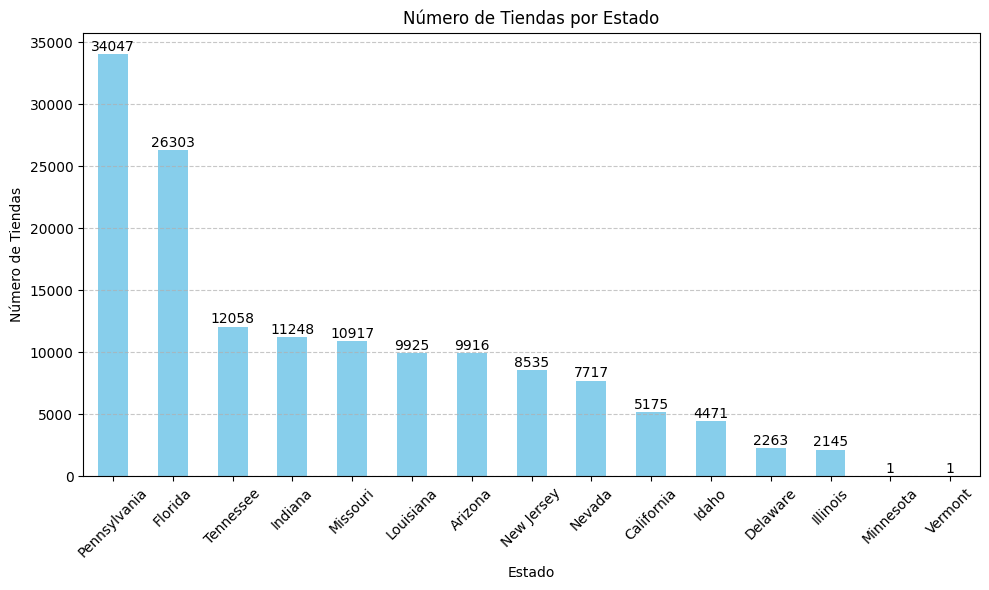

In [13]:
# Contar el número de tiendas por estado
tiendas_por_estado = df_business['state_name'].value_counts()

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
bars = tiendas_por_estado.plot(kind='bar', color='skyblue')
plt.title('Número de Tiendas por Estado')
plt.xlabel('Estado')
plt.ylabel('Número de Tiendas')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Agregar etiquetas de texto para mostrar la cantidad exacta en cada barra
for bar in bars.patches:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 20, round(yval), ha='center', va='bottom')

plt.tight_layout()

# Mostrar el gráfico
plt.show()

los estados con mayor cantidad de tiendas son: 
- pennsylvania
- florida

los cuales muestran una cantidad superior a los 300 locales

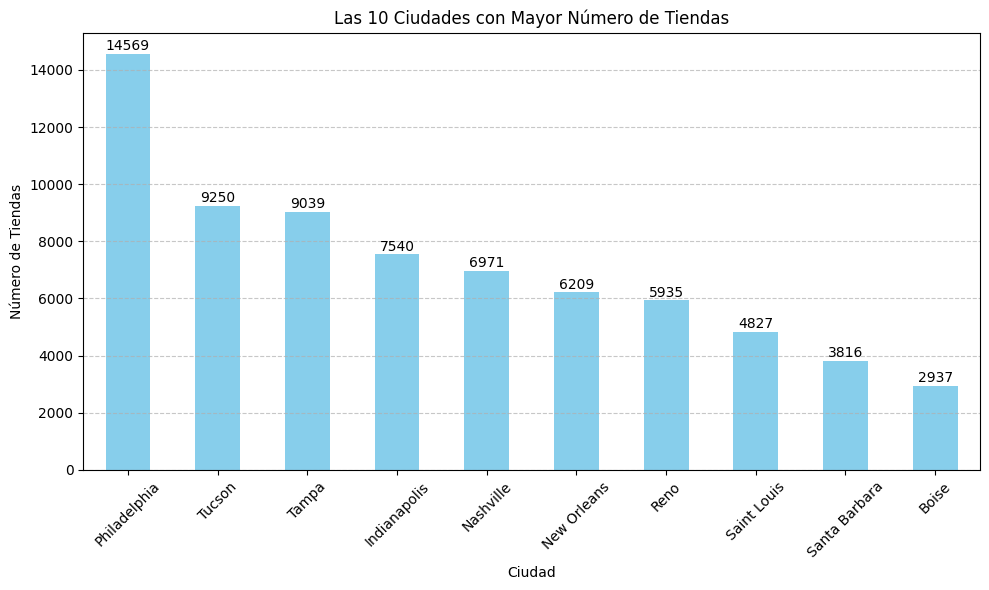

In [14]:
# Contar el número de tiendas por ciudad
tiendas_por_ciudad = df_business['city'].value_counts().head(10)

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
bars = tiendas_por_ciudad.plot(kind='bar', color='skyblue')
plt.title('Las 10 Ciudades con Mayor Número de Tiendas')
plt.xlabel('Ciudad')
plt.ylabel('Número de Tiendas')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Agregar etiquetas de texto para mostrar la cantidad exacta en cada barra
for bar in bars.patches:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 20, round(yval), ha='center', va='bottom')

plt.tight_layout()

# Mostrar el gráfico
plt.show()

Las ciudades con mayor numero de convenience stores registradas son Philadelphia, PA y Tucson, AZ. Mostrando una variación respecto al gráfico anterior.

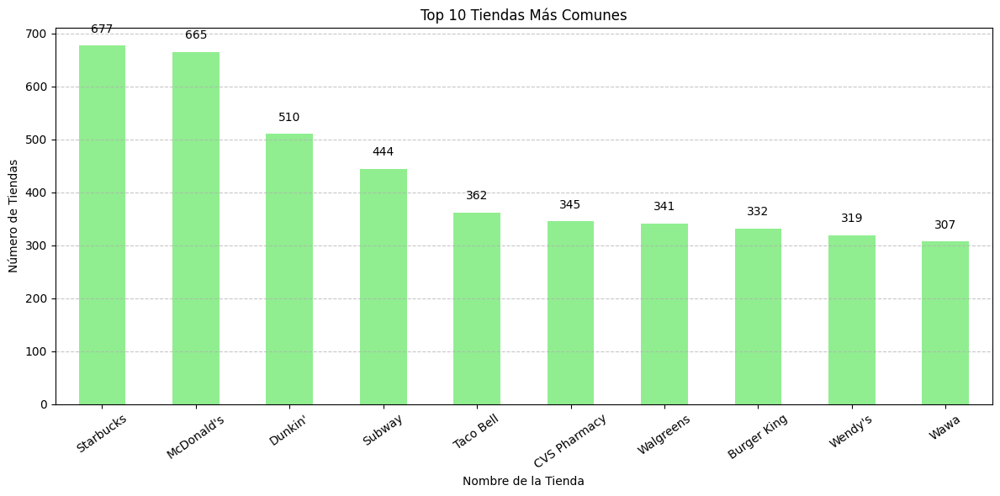

In [15]:
# Contar el número de tiendas por nombre de tienda
tiendas_por_nombre = df_business['name'].value_counts().head(10)  # Selecciona las 10 más comunes

# Crear el gráfico de barras
plt.figure(figsize=(12, 6))
bars = tiendas_por_nombre.plot(kind='bar', color='lightgreen')
plt.title('Top 10 Tiendas Más Comunes')
plt.xlabel('Nombre de la Tienda')
plt.ylabel('Número de Tiendas')
plt.xticks(rotation=35)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Agregar etiquetas de texto para mostrar la cantidad exacta en cada barra
for bar in bars.patches:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 20, round(yval), ha='center', va='bottom')

plt.tight_layout()

# Mostrar el gráfico
plt.show()

- Sturbucks se posiciona a la cabeza de los competidores en el rubro, con el mayor número de tiendas. Seguido muy de cerca por McDonald's. 

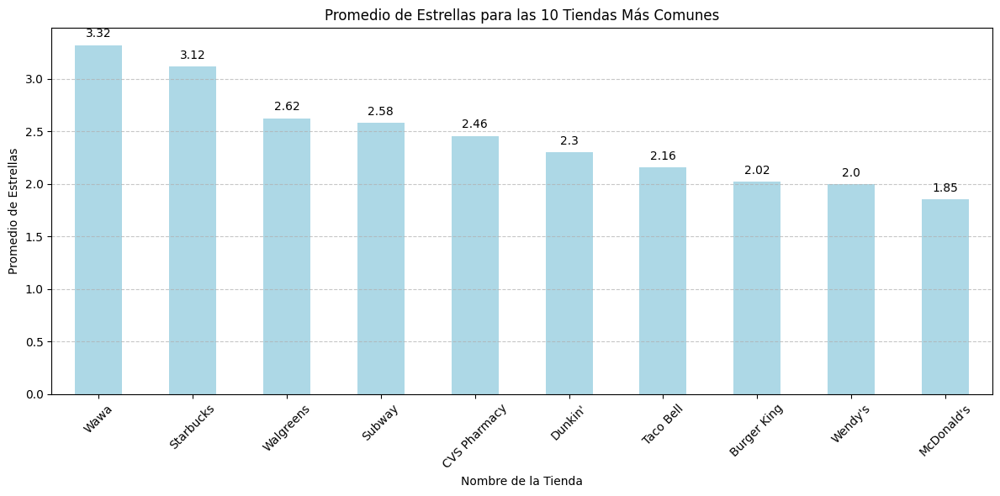

In [16]:
# Obtener las 10 tiendas más comunes
top_10_tiendas = df_business['name'].value_counts().head(10).index.tolist()

# Filtrar el DataFrame para incluir solo las filas correspondientes a las 10 tiendas más comunes
df_top_10_tiendas = df_business[df_business['name'].isin(top_10_tiendas)]

# Calcular el promedio de estrellas por nombre de tienda
promedio_estrellas_por_nombre = df_top_10_tiendas.groupby('name')['stars'].mean()

# Ordenar las tiendas por su promedio de estrellas de mayor a menor
promedio_estrellas_por_nombre = promedio_estrellas_por_nombre.sort_values(ascending=False)

# Crear el gráfico de barras
plt.figure(figsize=(12, 6))
bars = promedio_estrellas_por_nombre.plot(kind='bar', color='lightblue')
plt.title('Promedio de Estrellas para las 10 Tiendas Más Comunes')
plt.xlabel('Nombre de la Tienda')
plt.ylabel('Promedio de Estrellas')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Agregar etiquetas de texto para mostrar el promedio de estrellas en cada barra
for bar in bars.patches:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.05, round(yval, 2), ha='center', va='bottom')

plt.tight_layout()

# Mostrar el gráfico
plt.show()

- Respecto a las evaluación, Wawa encabeza la lista de las tiendas con mayor promedio de estrellas otorgadas. Dunkin' se encuentra en sexto lugar.

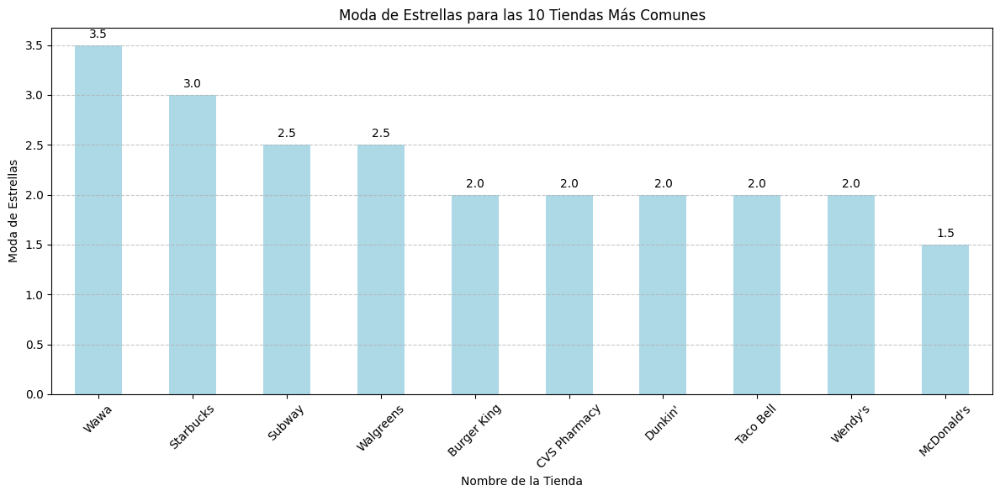

In [17]:
import matplotlib.pyplot as plt

# Obtener las 10 tiendas más comunes
top_10_tiendas = df_business['name'].value_counts().head(10).index.tolist()

# Filtrar el DataFrame para incluir solo las filas correspondientes a las 10 tiendas más comunes
df_top_10_tiendas = df_business[df_business['name'].isin(top_10_tiendas)]

# Calcular la moda de estrellas por nombre de tienda
moda_estrellas_por_nombre = df_top_10_tiendas.groupby('name')['stars'].agg(lambda x: x.mode().iloc[0])

# Ordenar las tiendas por su moda de estrellas de mayor a menor
moda_estrellas_por_nombre = moda_estrellas_por_nombre.sort_values(ascending=False)

# Crear el gráfico de barras
plt.figure(figsize=(12, 6))
bars = moda_estrellas_por_nombre.plot(kind='bar', color='lightblue')
plt.title('Moda de Estrellas para las 10 Tiendas Más Comunes')
plt.xlabel('Nombre de la Tienda')
plt.ylabel('Moda de Estrellas')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Agregar etiquetas de texto para mostrar la moda de estrellas en cada barra
for bar in bars.patches:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.05, round(yval, 2), ha='center', va='bottom')

plt.tight_layout()

# Mostrar el gráfico
plt.show()


Revisando la moda de la cantidad de estrellas, Wawa y Starbucks encabezan la lista. En septima posición, se encuentra Dunkin', junto con otras mas como Burguer King

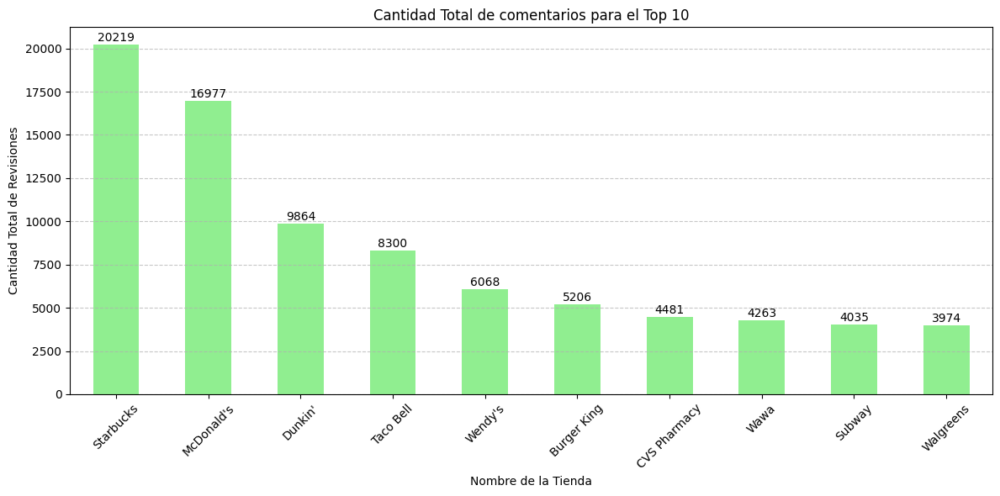

In [18]:
# Obtener las 10 tiendas más comunes
top_10_tiendas = df_business['name'].value_counts().head(10).index.tolist()

# Filtrar el DataFrame para incluir solo las filas correspondientes a las 10 tiendas más comunes
df_top_10_tiendas = df_business[df_business['name'].isin(top_10_tiendas)]

# Calcular la cantidad total de revisiones por nombre de tienda
total_reviews_por_nombre = df_top_10_tiendas.groupby('name')['review_count'].sum()

# Ordenar las tiendas por la cantidad total de revisiones de mayor a menor
total_reviews_por_nombre = total_reviews_por_nombre.sort_values(ascending=False)

# Crear el gráfico de barras
plt.figure(figsize=(12, 6))
bars = total_reviews_por_nombre.plot(kind='bar', color='lightgreen')
plt.title('Cantidad Total de comentarios para el Top 10')
plt.xlabel('Nombre de la Tienda')
plt.ylabel('Cantidad Total de Revisiones')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Agregar etiquetas de texto para mostrar la cantidad total de revisiones en cada barra
for bar in bars.patches:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 50, int(yval), ha='center', va='bottom')

plt.tight_layout()

# Mostrar el gráfico
plt.show()

- Respecto a la cantidad de comentarios, Dunking se encuentra en tercer lugar.

#### borra columnas 
 - elimina columnas "hours", "is_open" y "attributes" por no aportar información de valor para el análisis.

In [19]:
# Eliminar la columna 'hours' del DataFrame
df_business.drop(columns=['hours', 'is_open', 'attributes'], inplace=True)
df_business

,business_id,name,address,city,postal_code,latitude,longitude,stars,review_count,categories,state_name,state_code
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,93101,34.426679,-119.711197,5.0,7,"Doctors, Traditional Chinese Medicine, Naturop...",California,CA
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,63123,38.551126,-90.335695,3.0,15,"Shipping Centers, Local Services, Notaries, Ma...",Missouri,MO
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,85711,32.223236,-110.880452,3.5,22,"Department Stores, Shopping, Fashion, Home & G...",Arizona,AZ
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,19107,39.955505,-75.155564,4.0,80,"Restaurants, Food, Bubble Tea, Coffee & Tea, B...",Pennsylvania,PA
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,18054,40.338183,-75.471659,4.5,13,"Brewpubs, Breweries, Food",Pennsylvania,PA
...,...,...,...,...,...,...,...,...,...,...,...,...
150339,2O2K6SXPWv56amqxCECd4w,The Plum Pit,4405 Pennell Rd,Aston,19014,39.856185,-75.427725,4.5,14,"Restaurants, Comfort Food, Food, Food Trucks, ...",Pennsylvania,PA
150342,c8GjPIOTGVmIemT7j5_SyQ,Wild Birds Unlimited,2813 Bransford Ave,Nashville,37204,36.115118,-86.766925,4.0,5,"Pets, Nurseries & Gardening, Pet Stores, Hobby...",Tennessee,TN
150343,_QAMST-NrQobXduilWEqSw,Claire's Boutique,"6020 E 82nd St, Ste 46",Indianapolis,46250,39.908707,-86.065088,3.5,8,"Shopping, Jewelry, Piercing, Toy Stores, Beaut...",Indiana,IN
150344,mtGm22y5c2UHNXDFAjaPNw,Cyclery & Fitness Center,2472 Troy Rd,Edwardsville,62025,38.782351,-89.950558,4.0,24,"Fitness/Exercise Equipment, Eyewear & Optician...",Illinois,IL


## 2. Review

-  separa columna con la 'date', en columnas 'fecha' y 'hora', de cada review

In [20]:
# Convertir la columna 'date' a tipo datetime
df_review['fecha'] = pd.to_datetime(df_review['date'])

# Extraer solo la fecha (year-month-day)
df_review['fecha'] = df_review['fecha'].dt.strftime('%Y-%m-%d')

# Mostrar solo la columna 'fecha'
df_review

,review_id,user_id,business_id,stars,useful,funny,cool,text,date,fecha
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11,2018-07-07
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18,2012-01-03
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30,2014-02-05
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03,2015-01-04
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15,2017-01-14
...,...,...,...,...,...,...,...,...,...,...
6990275,t-2o35kr7Q9DSaeuKhaDuQ,oX7o1TH0PHUWp9r9ry9_vw,jLn69WQupjsDKrbPw_nlGQ,3,0,1,0,Never really had any issues here other than th...,2017-11-15 09:43:07,2017-11-15
6990276,fLIwWCvdul9PNWYfJt5QWA,v8wlapFKVLs2qTYCGhCdiw,t6v8g8UeNiq3O2GoEc7R4Q,4,0,0,0,Fish recently moved a couple of doors down the...,2014-09-03 18:27:33,2014-09-03
6990277,ETAiy6wEM-r9ve4SKDhBpg,rLlYc1RzIBnOmnX3AbpEYw,ZYRul0i1bhOjirHED6Kd0w,3,0,0,0,I've been to South House around a dozen or so ...,2016-02-20 22:25:29,2016-02-20
6990278,8OgvSXuc6KjAt2fSz9LuzA,eEH-8CEPU5ndPxDGzVfHiQ,onGXKwnxPLtKnO8yqQMPSA,1,1,0,1,Wow! I am shocked at these reviews. I have tri...,2010-06-27 02:17:30,2010-06-27


In [21]:
# Convertir la columna 'columna_fecha_hora' a tipo datetime y extraer solo la hora
df_review['hora_review'] = pd.to_datetime(df_review['date']).dt.hour

# Mostrar las primeras filas del DataFrame para verificar el cambio
df_review

,review_id,user_id,business_id,stars,useful,funny,cool,text,date,fecha,hora_review
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11,2018-07-07,22
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18,2012-01-03,15
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30,2014-02-05,20
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03,2015-01-04,0
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15,2017-01-14,20
...,...,...,...,...,...,...,...,...,...,...,...
6990275,t-2o35kr7Q9DSaeuKhaDuQ,oX7o1TH0PHUWp9r9ry9_vw,jLn69WQupjsDKrbPw_nlGQ,3,0,1,0,Never really had any issues here other than th...,2017-11-15 09:43:07,2017-11-15,9
6990276,fLIwWCvdul9PNWYfJt5QWA,v8wlapFKVLs2qTYCGhCdiw,t6v8g8UeNiq3O2GoEc7R4Q,4,0,0,0,Fish recently moved a couple of doors down the...,2014-09-03 18:27:33,2014-09-03,18
6990277,ETAiy6wEM-r9ve4SKDhBpg,rLlYc1RzIBnOmnX3AbpEYw,ZYRul0i1bhOjirHED6Kd0w,3,0,0,0,I've been to South House around a dozen or so ...,2016-02-20 22:25:29,2016-02-20,22
6990278,8OgvSXuc6KjAt2fSz9LuzA,eEH-8CEPU5ndPxDGzVfHiQ,onGXKwnxPLtKnO8yqQMPSA,1,1,0,1,Wow! I am shocked at these reviews. I have tri...,2010-06-27 02:17:30,2010-06-27,2


- agrega una columna con el analisis de sentimiento de la columna "text".

In [22]:
# Función para realizar análisis de sentimiento y devolver valores enteros entre -1, 0 y 1
def analizar_sentimiento(texto):
    # Crear un objeto TextBlob
    blob = TextBlob(str(texto))
    # Obtener la polaridad del sentimiento (-1 a 1)
    polaridad = blob.sentiment.polarity
    # Convertir la polaridad a valores enteros entre -1, 0 y 1
    if polaridad < 0:
        return -1
    elif polaridad == 0:
        return 0
    else:
        return 1

# Aplicar el análisis de sentimiento a la columna 'text' y crear una nueva columna 'sentimental_analysis'
df_review['sentimental_analysis'] = df_review['text'].apply(analizar_sentimiento)

# Mostrar el DataFrame con la nueva columna 'sentimental_analysis'
df_review

,review_id,user_id,business_id,stars,useful,funny,cool,text,date,fecha,hora_review,sentimental_analysis
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11,2018-07-07,22,1
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18,2012-01-03,15,1
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30,2014-02-05,20,1
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03,2015-01-04,0,1
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15,2017-01-14,20,1
...,...,...,...,...,...,...,...,...,...,...,...,...
6990275,t-2o35kr7Q9DSaeuKhaDuQ,oX7o1TH0PHUWp9r9ry9_vw,jLn69WQupjsDKrbPw_nlGQ,3,0,1,0,Never really had any issues here other than th...,2017-11-15 09:43:07,2017-11-15,9,1
6990276,fLIwWCvdul9PNWYfJt5QWA,v8wlapFKVLs2qTYCGhCdiw,t6v8g8UeNiq3O2GoEc7R4Q,4,0,0,0,Fish recently moved a couple of doors down the...,2014-09-03 18:27:33,2014-09-03,18,1
6990277,ETAiy6wEM-r9ve4SKDhBpg,rLlYc1RzIBnOmnX3AbpEYw,ZYRul0i1bhOjirHED6Kd0w,3,0,0,0,I've been to South House around a dozen or so ...,2016-02-20 22:25:29,2016-02-20,22,1
6990278,8OgvSXuc6KjAt2fSz9LuzA,eEH-8CEPU5ndPxDGzVfHiQ,onGXKwnxPLtKnO8yqQMPSA,1,1,0,1,Wow! I am shocked at these reviews. I have tri...,2010-06-27 02:17:30,2010-06-27,2,-1


- desde 'business' agrega los nombres a cada business_id

In [23]:
def agregar_nombres_locales(df_review, df_business):
    # Crear un diccionario de mapeo de business_id a nombres de locales
    mapping = df_business.set_index('business_id')['name'].to_dict()
    
    # Agregar una nueva columna 'nombre_local' al DataFrame df_review
    df_review['name_business'] = df_review['business_id'].map(mapping)
    
    # Devolver el DataFrame df_review con la nueva columna agregada
    return df_review

# Llamar a la función para agregar la columna de nombres de locales
df_review = agregar_nombres_locales(df_review, df_business)

# Mostrar el DataFrame resultante
df_review

,review_id,user_id,business_id,stars,useful,funny,cool,text,date,fecha,hora_review,sentimental_analysis,name_business
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11,2018-07-07,22,1,Turning Point of North Wales
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18,2012-01-03,15,1,Body Cycle Spinning Studio
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30,2014-02-05,20,1,Kettle Restaurant
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03,2015-01-04,0,1,Zaika
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15,2017-01-14,20,1,Melt
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6990275,t-2o35kr7Q9DSaeuKhaDuQ,oX7o1TH0PHUWp9r9ry9_vw,jLn69WQupjsDKrbPw_nlGQ,3,0,1,0,Never really had any issues here other than th...,2017-11-15 09:43:07,2017-11-15,9,1,Yogurtland Santa Barbara
6990276,fLIwWCvdul9PNWYfJt5QWA,v8wlapFKVLs2qTYCGhCdiw,t6v8g8UeNiq3O2GoEc7R4Q,4,0,0,0,Fish recently moved a couple of doors down the...,2014-09-03 18:27:33,2014-09-03,18,1,Fish
6990277,ETAiy6wEM-r9ve4SKDhBpg,rLlYc1RzIBnOmnX3AbpEYw,ZYRul0i1bhOjirHED6Kd0w,3,0,0,0,I've been to South House around a dozen or so ...,2016-02-20 22:25:29,2016-02-20,22,1,SouthHouse
6990278,8OgvSXuc6KjAt2fSz9LuzA,eEH-8CEPU5ndPxDGzVfHiQ,onGXKwnxPLtKnO8yqQMPSA,1,1,0,1,Wow! I am shocked at these reviews. I have tri...,2010-06-27 02:17:30,2010-06-27,2,-1,Cupcakes Gourmet


- reordena las columnas para mejor lectura/entendimiento

In [24]:
df_review.columns

Index(['review_id', 'user_id', 'business_id', 'stars', 'useful', 'funny',
       'cool', 'text', 'date', 'fecha', 'hora_review', 'sentimental_analysis',
       'name_business'],
      dtype='object')

In [25]:
"""
'business_id', 
'name_business',
'review_id', 
'user_id', 
'date',
'fecha', 
'hora_review', 
'stars', 
'useful', 
'funny',
'cool',
'text',
'sentimental_analysis'
"""

"\n'business_id', \n'name_business',\n'review_id', \n'user_id', \n'date',\n'fecha', \n'hora_review', \n'stars', \n'useful', \n'funny',\n'cool',\n'text',\n'sentimental_analysis'\n"

In [26]:
# Lista con el orden deseado de las columnas
orden_columnas = ['business_id', 'name_business','review_id', 'user_id', 'date','fecha', 
                  'hora_review', 'stars', 'useful', 'funny','cool','text','sentimental_analysis']

# Reordenar las columnas del DataFrame
df_review = df_review[orden_columnas]

In [27]:
df_review.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6990280 entries, 0 to 6990279
Data columns (total 13 columns):
 #   Column                Dtype         
---  ------                -----         
 0   business_id           object        
 1   name_business         object        
 2   review_id             object        
 3   user_id               object        
 4   date                  datetime64[ns]
 5   fecha                 object        
 6   hora_review           int32         
 7   stars                 int64         
 8   useful                int64         
 9   funny                 int64         
 10  cool                  int64         
 11  text                  object        
 12  sentimental_analysis  int64         
dtypes: datetime64[ns](1), int32(1), int64(5), object(6)
memory usage: 666.6+ MB


- elimina las filas con valores nulos en columna 'name_business' para evitar fallas a futuro.

In [28]:
# Eliminar filas con valores nulos en la columna 'name_business'
df_review = df_review.dropna(subset=['name_business'])
df_review

,business_id,name_business,review_id,user_id,date,fecha,hora_review,stars,useful,funny,cool,text,sentimental_analysis
0,XQfwVwDr-v0ZS3_CbbE5Xw,Turning Point of North Wales,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,2018-07-07 22:09:11,2018-07-07,22,3,0,0,0,"If you decide to eat here, just be aware it is...",1
1,7ATYjTIgM3jUlt4UM3IypQ,Body Cycle Spinning Studio,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,2012-01-03 15:28:18,2012-01-03,15,5,1,0,1,I've taken a lot of spin classes over the year...,1
2,YjUWPpI6HXG530lwP-fb2A,Kettle Restaurant,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,2014-02-05 20:30:30,2014-02-05,20,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,1
3,kxX2SOes4o-D3ZQBkiMRfA,Zaika,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,2015-01-04 00:01:03,2015-01-04,0,5,1,0,1,"Wow! Yummy, different, delicious. Our favo...",1
4,e4Vwtrqf-wpJfwesgvdgxQ,Melt,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,2017-01-14 20:54:15,2017-01-14,20,4,1,0,1,Cute interior and owner (?) gave us tour of up...,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6990275,jLn69WQupjsDKrbPw_nlGQ,Yogurtland Santa Barbara,t-2o35kr7Q9DSaeuKhaDuQ,oX7o1TH0PHUWp9r9ry9_vw,2017-11-15 09:43:07,2017-11-15,9,3,0,1,0,Never really had any issues here other than th...,1
6990276,t6v8g8UeNiq3O2GoEc7R4Q,Fish,fLIwWCvdul9PNWYfJt5QWA,v8wlapFKVLs2qTYCGhCdiw,2014-09-03 18:27:33,2014-09-03,18,4,0,0,0,Fish recently moved a couple of doors down the...,1
6990277,ZYRul0i1bhOjirHED6Kd0w,SouthHouse,ETAiy6wEM-r9ve4SKDhBpg,rLlYc1RzIBnOmnX3AbpEYw,2016-02-20 22:25:29,2016-02-20,22,3,0,0,0,I've been to South House around a dozen or so ...,1
6990278,onGXKwnxPLtKnO8yqQMPSA,Cupcakes Gourmet,8OgvSXuc6KjAt2fSz9LuzA,eEH-8CEPU5ndPxDGzVfHiQ,2010-06-27 02:17:30,2010-06-27,2,1,1,0,1,Wow! I am shocked at these reviews. I have tri...,-1


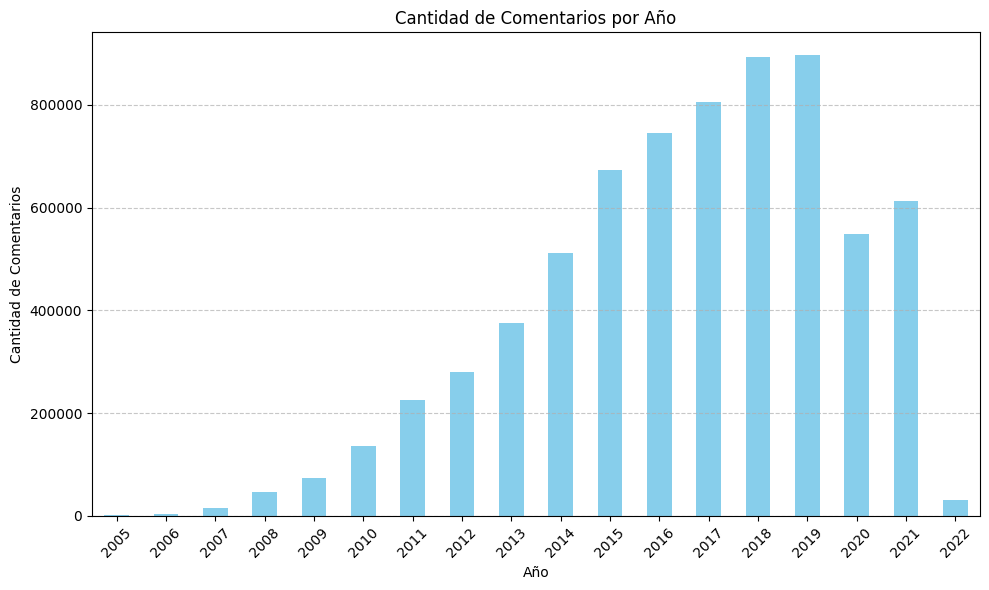

In [29]:

# Convertir la columna 'fecha' a tipo datetime en el momento de graficar
df_review['fecha'] = pd.to_datetime(df_review['fecha'])

# Agrupar por año y contar la cantidad de comentarios en cada año
comentarios_por_año = df_review['fecha'].dt.year.value_counts().sort_index()

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
comentarios_por_año.plot(kind='bar', color='skyblue')
plt.title('Cantidad de Comentarios por Año')
plt.xlabel('Año')
plt.ylabel('Cantidad de Comentarios')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Mostrar el gráfico
plt.show()

- Se aprecia un alza en la cantidad de reseñas. Siendo 2019 el año con más registros. Posterior a esa fecha se aprecia una baja, pero se debe profundizar el análisis para comprender la causa de este fenómeno. 

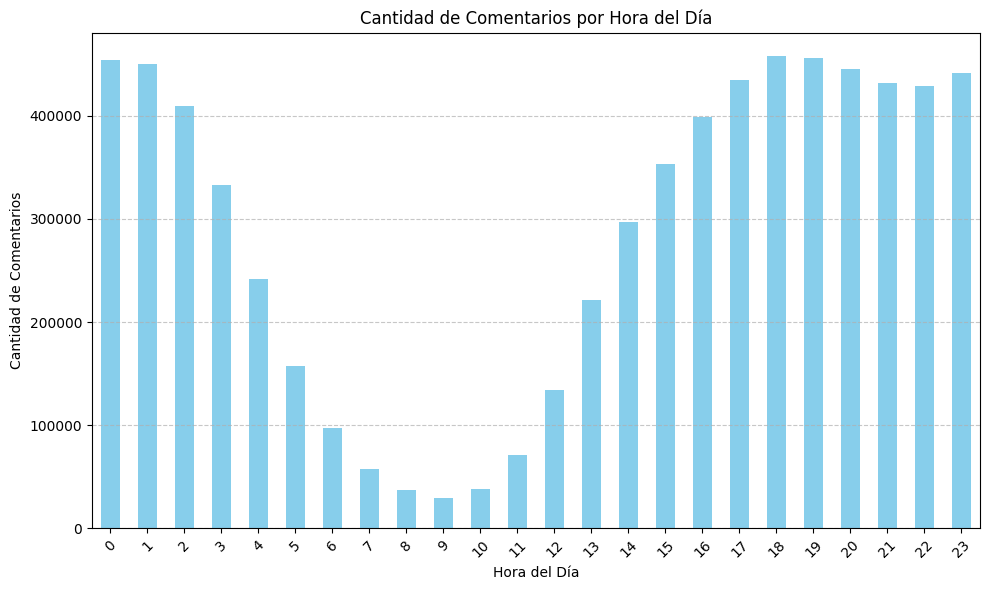

In [30]:
# Agrupar por hora y contar la cantidad de comentarios en cada hora
comentarios_por_hora = df_review['hora_review'].value_counts().sort_index()

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
comentarios_por_hora.plot(kind='bar', color='skyblue')
plt.title('Cantidad de Comentarios por Hora del Día')
plt.xlabel('Hora del Día')
plt.ylabel('Cantidad de Comentarios')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Mostrar el gráfico
plt.show()

- La data muestra una tendencia clara respecto las horas con mayor y menor actividad de los usuarios reseñando. El tramo entre las 8 y las 9 am es el menos activo.

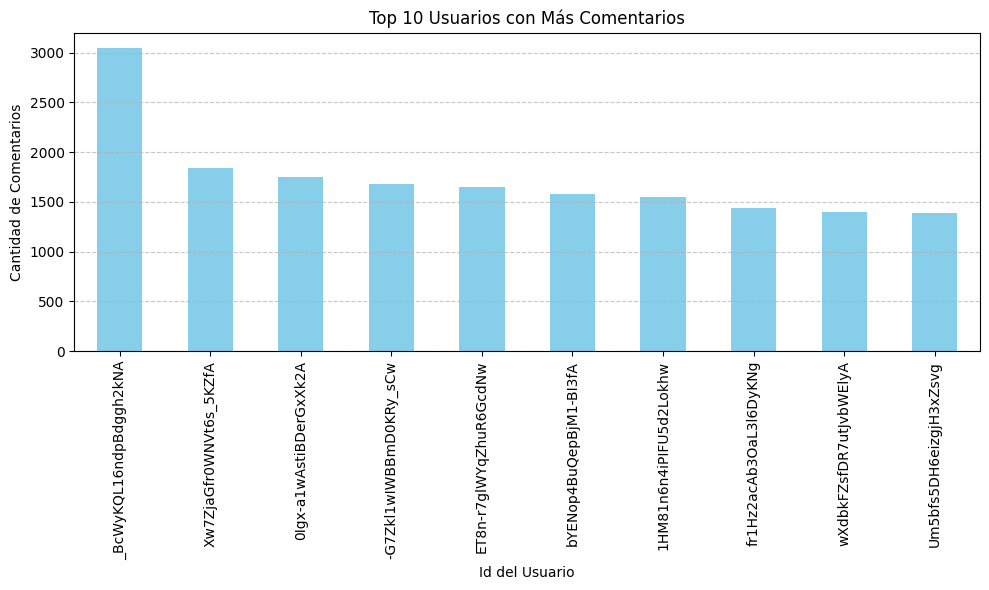

In [31]:
# Contar la cantidad de comentarios por usuario
comentarios_por_usuario = df_review['user_id'].value_counts()

# Obtener los 10 usuarios con más comentarios
top_10_usuarios = comentarios_por_usuario.head(10)

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
top_10_usuarios.plot(kind='bar', color='skyblue')
plt.title('Top 10 Usuarios con Más Comentarios')
plt.xlabel('Id del Usuario')
plt.ylabel('Cantidad de Comentarios')
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Mostrar el gráfico
plt.show()

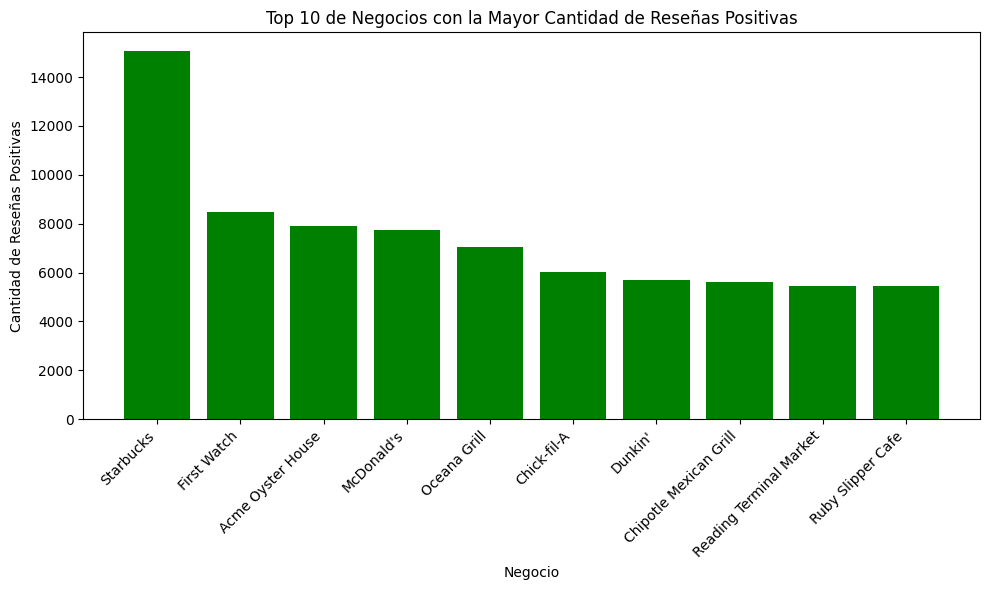

In [32]:
# Filtrar las reseñas con análisis sentimental positivo
reseñas_positivas = df_review[df_review['sentimental_analysis'] == 1]

# Contar la cantidad de reseñas positivas por negocio
cantidad_reseñas_positivas_por_negocio = reseñas_positivas.groupby('name_business').size()

# Seleccionar los 10 negocios con más reseñas positivas
top_10_negocios_positivos = cantidad_reseñas_positivas_por_negocio.nlargest(10)

# Obtener los nombres de los negocios y la cantidad de reseñas positivas
nombres_negocios = top_10_negocios_positivos.index
cantidad_reseñas_positivas = top_10_negocios_positivos.values

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.bar(nombres_negocios, cantidad_reseñas_positivas, color='green')
plt.title('Top 10 de Negocios con la Mayor Cantidad de Reseñas Positivas')
plt.xlabel('Negocio')
plt.ylabel('Cantidad de Reseñas Positivas')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Mostrar el gráfico
plt.show()

- En base a la columna de análisis de sentimiento, Sturbucks lidera la lista de locales con mejor recepción por parte de los usuarios. Dunkin' ocupa el septimo puesto. 

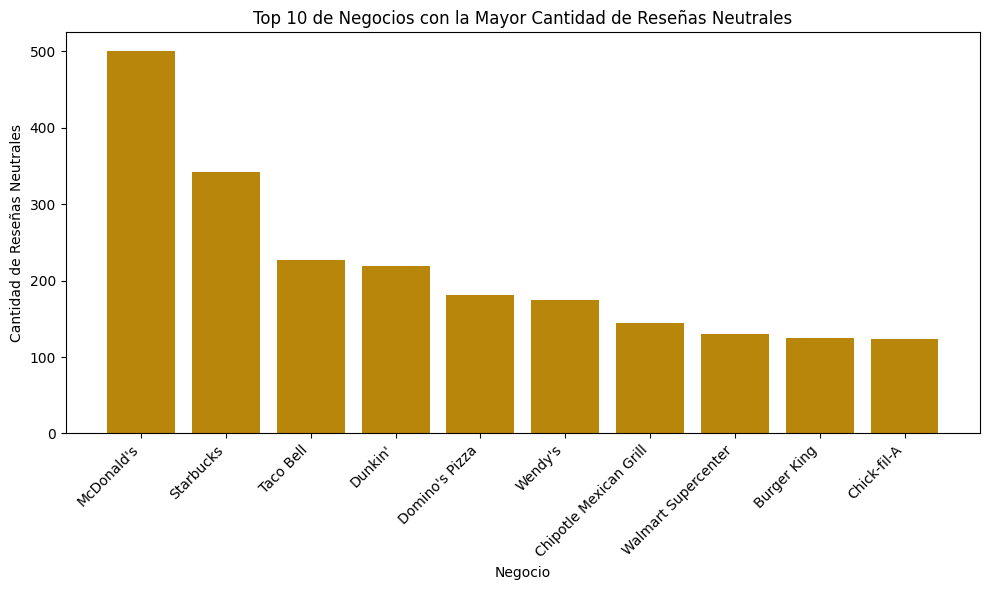

In [33]:
# Filtrar las reseñas con análisis sentimental neutro
reseñas_neutrales = df_review[df_review['sentimental_analysis'] == 0]

# Contar la cantidad de reseñas neutrales por negocio
cantidad_reseñas_neutrales_por_negocio = reseñas_neutrales.groupby('name_business').size()

# Seleccionar los 10 negocios con más reseñas neutrales
top_10_negocios_neutrales = cantidad_reseñas_neutrales_por_negocio.nlargest(10)

# Obtener los nombres de los negocios y la cantidad de reseñas neutrales
nombres_negocios = top_10_negocios_neutrales.index
cantidad_reseñas_neutrales = top_10_negocios_neutrales.values

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.bar(nombres_negocios, cantidad_reseñas_neutrales, color='darkgoldenrod')
plt.title('Top 10 de Negocios con la Mayor Cantidad de Reseñas Neutrales')
plt.xlabel('Negocio')
plt.ylabel('Cantidad de Reseñas Neutrales')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Mostrar el gráfico
plt.show()

- En el caso de reseñas de caracter neutral, McDonalds lidera la lista. Dunkin' se ubica en el cuarto lugar

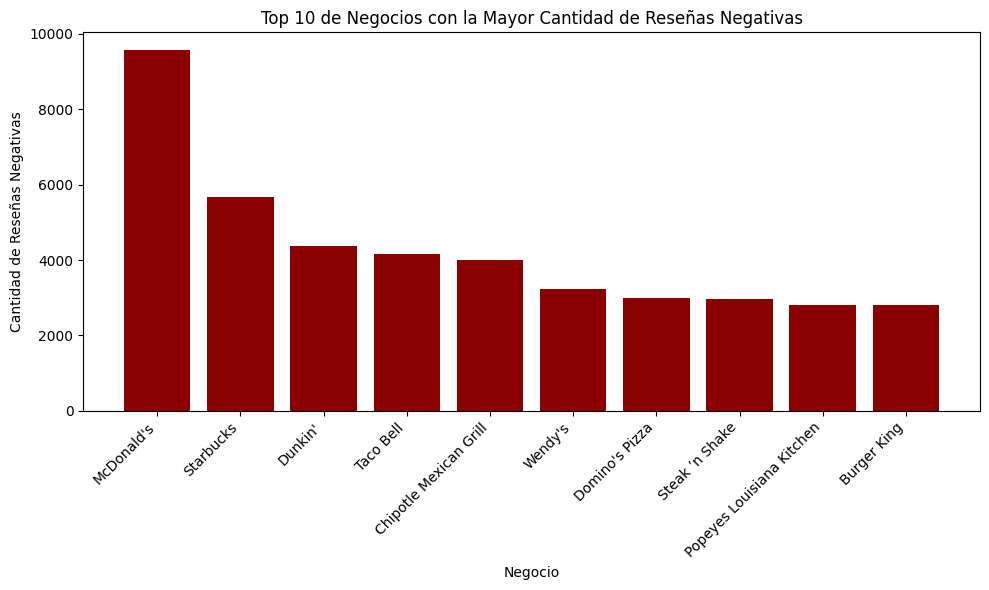

In [34]:
# Filtrar las reseñas con análisis sentimental negativo
reseñas_negativas = df_review[df_review['sentimental_analysis'] == -1]

# Contar la cantidad de reseñas negativas por negocio
cantidad_reseñas_negativas_por_negocio = reseñas_negativas.groupby('name_business').size()

# Seleccionar los 10 negocios con más reseñas negativas
top_10_negocios_negativos = cantidad_reseñas_negativas_por_negocio.nlargest(10)

# Obtener los nombres de los negocios y la cantidad de reseñas negativas
nombres_negocios = top_10_negocios_negativos.index
cantidad_reseñas_negativas = top_10_negocios_negativos.values

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.bar(nombres_negocios, cantidad_reseñas_negativas, color='darkred')
plt.title('Top 10 de Negocios con la Mayor Cantidad de Reseñas Negativas')
plt.xlabel('Negocio')
plt.ylabel('Cantidad de Reseñas Negativas')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Mostrar el gráfico
plt.show()

- Respecto a las reseñas negativas, McDonalds vuelve a encabezar la lista, con Dunkin' ocupando el tercer lugar. Es notoria la diferencia en la proporción de reseñas negativas, positivas y neutras. Siendo las primeras las mayoritarias.

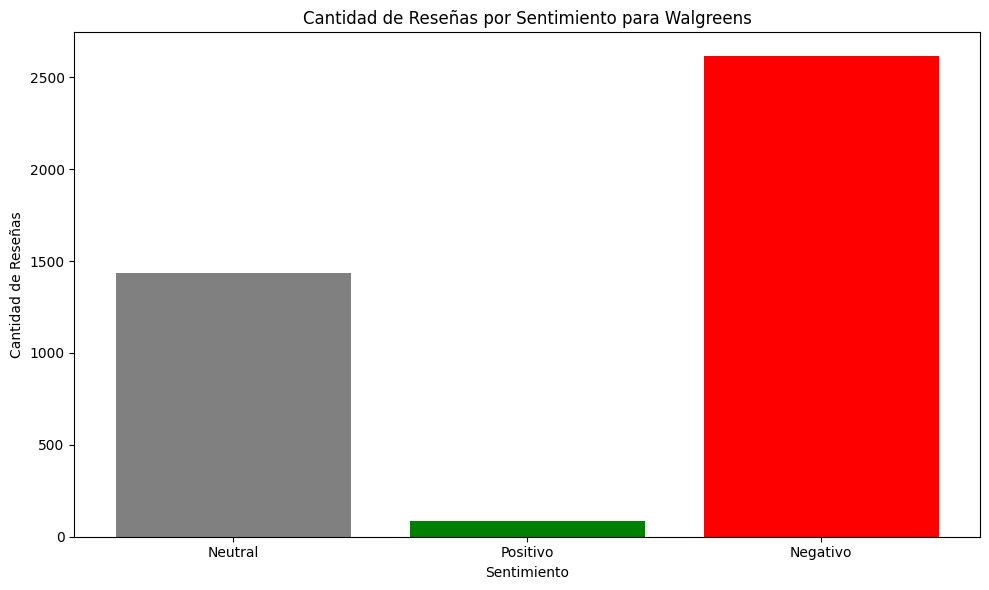

Cantidad de reseñas por tipo de sentimiento para Walgreens:
sentimental_analysis
 1    2614
-1    1434
 0      88
Name: count, dtype: int64

Porcentaje de reseñas por tipo de sentimiento para Walgreens:
sentimental_analysis
 1    63.201161
-1    34.671180
 0     2.127660
Name: count, dtype: float64


In [35]:
# Filtrar las reseñas para el negocio Walgreens
reseñas_walgreens = df_review[df_review['name_business'] == 'Walgreens']

# Contar la cantidad de reseñas por tipo de sentimiento para Walgreens
cantidad_reseñas_por_sentimiento = reseñas_walgreens['sentimental_analysis'].value_counts()

# Calcular el porcentaje de reseñas por tipo de sentimiento para Walgreens
porcentaje_reseñas_por_sentimiento = (cantidad_reseñas_por_sentimiento / len(reseñas_walgreens)) * 100

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.bar(cantidad_reseñas_por_sentimiento.index, cantidad_reseñas_por_sentimiento, color=['red', 'gray', 'green'])
plt.title('Cantidad de Reseñas por Sentimiento para Walgreens')
plt.xlabel('Sentimiento')
plt.ylabel('Cantidad de Reseñas')
plt.xticks(cantidad_reseñas_por_sentimiento.index, ['Negativo', 'Neutral', 'Positivo'])
plt.tight_layout()

# Mostrar el gráfico
plt.show()

# Imprimir la cantidad y el porcentaje de reseñas por tipo de sentimiento para Walgreens
print("Cantidad de reseñas por tipo de sentimiento para Walgreens:")
print(cantidad_reseñas_por_sentimiento)
print("\nPorcentaje de reseñas por tipo de sentimiento para Walgreens:")
print(porcentaje_reseñas_por_sentimiento)

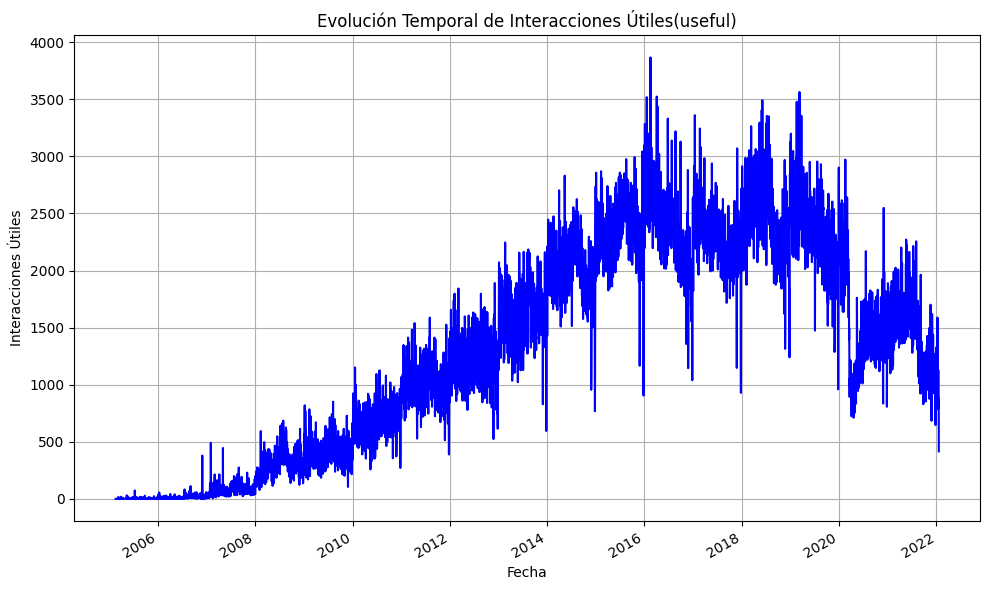

In [36]:
# Agrupar por fecha y sumar las interacciones "useful" por día
interacciones_useful_por_dia = df_review.groupby('fecha')['useful'].sum()

# Crear el gráfico de línea
plt.figure(figsize=(10, 6))
interacciones_useful_por_dia.plot(color='blue')
plt.title('Evolución Temporal de Interacciones Útiles(useful)')
plt.xlabel('Fecha')
plt.ylabel('Interacciones Útiles')
plt.grid(True)
plt.tight_layout()
plt.show()


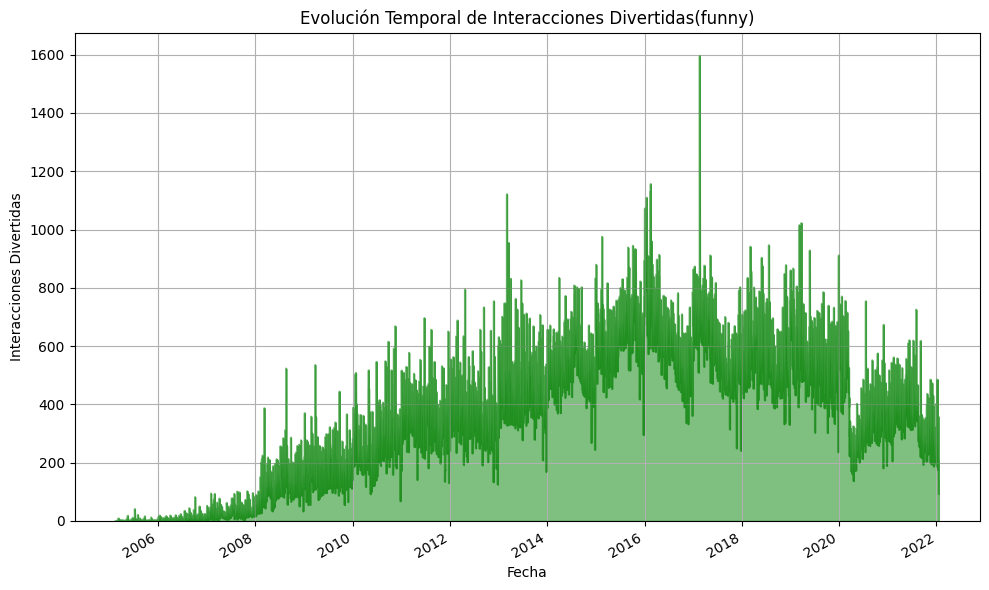

In [37]:
# Agrupar por fecha y sumar las interacciones "funny" por día
interacciones_funny_por_dia = df_review.groupby('fecha')['funny'].sum()

# Crear el gráfico de área
plt.figure(figsize=(10, 6))
interacciones_funny_por_dia.plot(kind='area', color='green', alpha=0.5)
plt.title('Evolución Temporal de Interacciones Divertidas(funny)')
plt.xlabel('Fecha')
plt.ylabel('Interacciones Divertidas')
plt.grid(True)
plt.tight_layout()
plt.show()

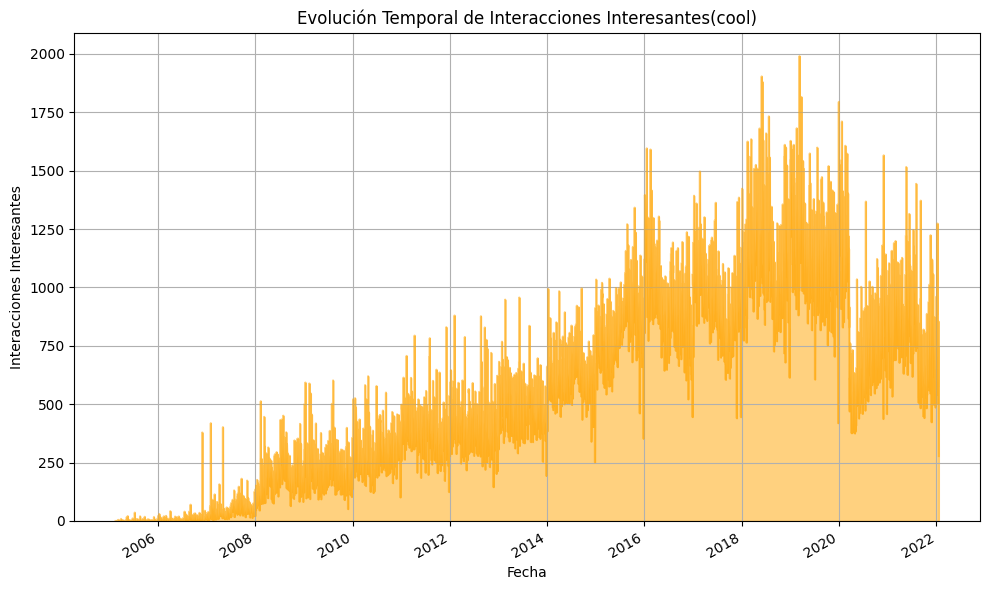

In [38]:
# Agrupar por fecha y sumar las interacciones "cool" por día
interacciones_funny_por_dia = df_review.groupby('fecha')['cool'].sum()

# Crear el gráfico de área
plt.figure(figsize=(10, 6))
interacciones_funny_por_dia.plot(kind='area', color='orange', alpha=0.5)
plt.title('Evolución Temporal de Interacciones Interesantes(cool)')
plt.xlabel('Fecha')
plt.ylabel('Interacciones Interesantes')
plt.grid(True)
plt.tight_layout()
plt.show()

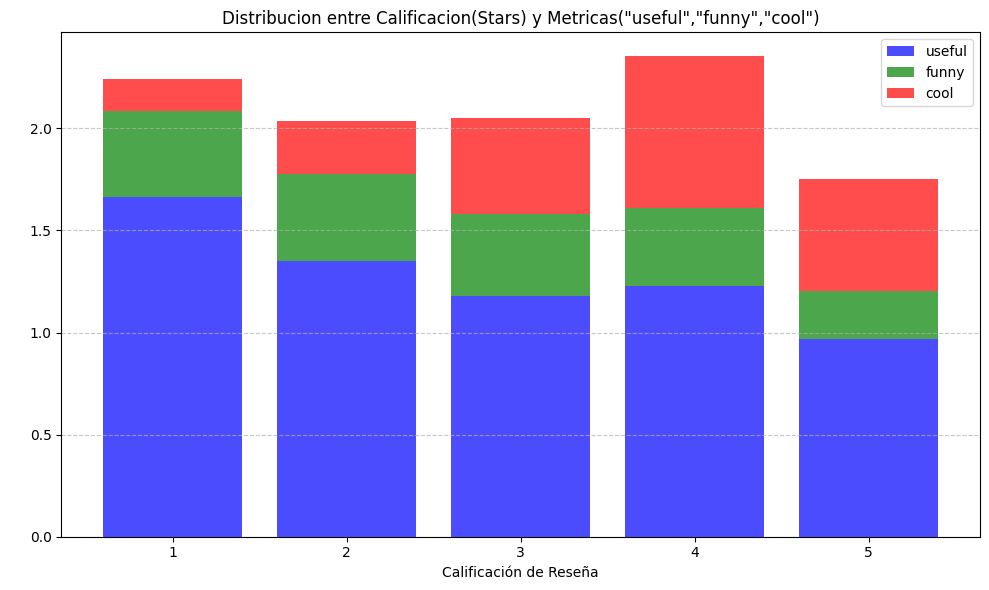

In [39]:
# Calcular el promedio de cada columna para cada calificación de reseña
useful_mean = df_review.groupby('stars')['useful'].mean()
funny_mean = df_review.groupby('stars')['funny'].mean()
cool_mean = df_review.groupby('stars')['cool'].mean()

# Crear el gráfico de barras apiladas
plt.figure(figsize=(10, 6))

# Barras para la columna 'useful'
plt.bar(useful_mean.index, useful_mean, color='blue', label='useful', alpha=0.7)

# Barras para la columna 'funny'
plt.bar(funny_mean.index, funny_mean, bottom=useful_mean, color='green', label='funny', alpha=0.7)

# Barras para la columna 'cool'
plt.bar(cool_mean.index, cool_mean, bottom=useful_mean + funny_mean, color='red', label='cool', alpha=0.7)

plt.title('Distribucion entre Calificacion(Stars) y Metricas("useful","funny","cool")')
plt.xlabel('Calificación de Reseña')
plt.ylabel('  ')
plt.legend()
plt.xticks(range(1, 6))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Mostrar el gráfico
plt.show()